In [1]:
import sys
sys.path.append("..")

from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.neighbors import KDTree
import torch
import torchvision
import yaml

import datasets
from datasets import preprocessing
from utils import main_utils

In [2]:
class Args:
    rank = -1
    quiet = False

args = Args()

cfg = yaml.safe_load(open("../configs/main/avid/kinetics/Cross-N1024.yaml"))
logger, tb_writter, model_dir = main_utils.prep_environment(args, cfg)

In [3]:
model = main_utils.build_model(cfg['model'], logger)
state_dict = torch.load("../checkpoints/AVID/kinetics/Cross-N1024/checkpoint.pth.tar", map_location=torch.device('cpu'))
model.load_state_dict({k.replace('module.', ''): state_dict['model'][k] for k in state_dict['model']})
model.eval()

AV_Wrapper(
  (video_model): R2Plus1D(
    (conv1): Sequential(
      (0): Conv3d(3, 64, kernel_size=(3, 7, 7), stride=(1, 2, 2), padding=(1, 3, 3), bias=False)
      (1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool3d(kernel_size=(1, 3, 3), stride=(1, 2, 2), padding=(0, 1, 1), dilation=1, ceil_mode=False)
    )
    (conv2x): Sequential(
      (0): BasicR2P1DBlock(
        (spt_conv1): Conv3d(64, 64, kernel_size=(1, 3, 3), stride=(1, 1, 1), padding=(0, 1, 1), bias=False)
        (spt_bn1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (tmp_conv1): Conv3d(64, 64, kernel_size=(3, 1, 1), stride=(1, 1, 1), padding=(1, 0, 0), bias=False)
        (tmp_bn1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (spt_conv2): Conv3d(64, 64, kernel_size=(1, 3, 3), stride=(1, 1, 1), padding=(0, 1, 1), bias=False)
        (spt_bn2): BatchNo

In [4]:
video_transform = preprocessing.VideoPrep_MSC_CJ(
            crop=(224, 224),
            augment=False,
            num_frames=0.5 * 16,
            pad_missing=True,
        )
audio_transform = [
    preprocessing.AudioPrep(
        trim_pad=True,
        duration=2,
        augment=False,
        missing_as_zero=True),
    preprocessing.LogSpectrogram(
        24000,
        n_fft=512,
        hop_size=1. / 100,
        normalize=True)
]

In [5]:
dataset = datasets.Kinetics(
    subset="test",
    return_video=True,
    video_clip_duration=0.5,
    video_fps=16,
    video_transform=video_transform,
    return_audio=True,
    audio_clip_duration=2,
    audio_fps=24000,
    audio_fps_out=64,
    audio_transform=audio_transform,
    max_offsync_augm=0,
    return_labels=True,
    return_index=True,
    mode='clip',
    clips_per_video=10,
)
dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size=256,
    shuffle=True,
    drop_last=True,
    num_workers=0,
    pin_memory=True,
    sampler=None
)

In [6]:
def scale_to_zero_one(t):
    return (t - t.min()) / (t.max() - t.min())

def plot_pics(index, title):
    pic = sample["frames"][index, :, 0, :, :]
    pic = torchvision.transforms.functional.rotate(pic, 90)
    pic = torchvision.transforms.functional.vflip(pic)
    pic = pic.transpose(0, 2)
    plt.imshow(scale_to_zero_one(pic))
    plt.title(title)

In [7]:
for sample in dataloader:
    with torch.no_grad():
        logits = model(sample["frames"], sample["audio"])
        video_enc = logits[0]
        audio_enc = logits[1]
    break

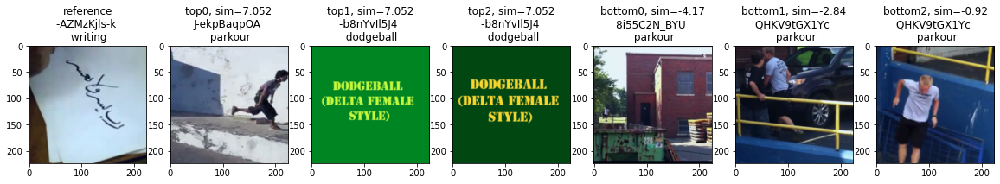

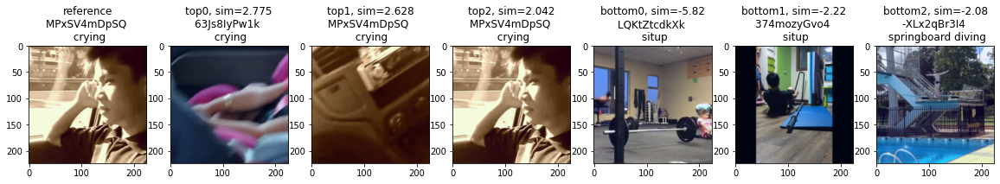

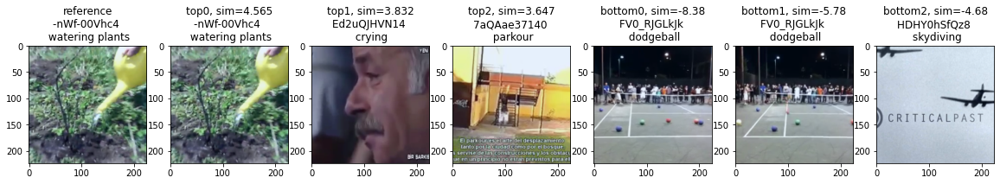

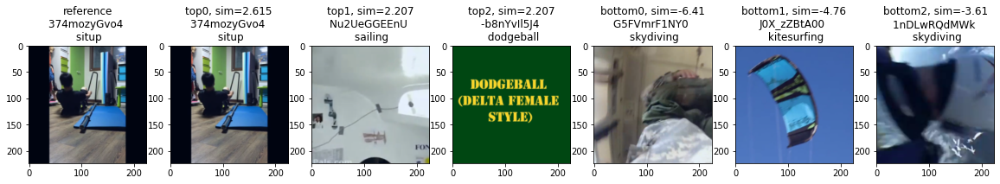

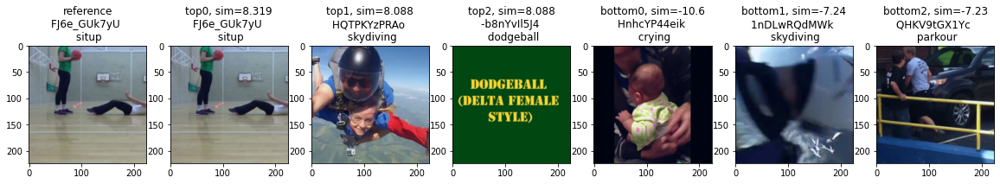

...

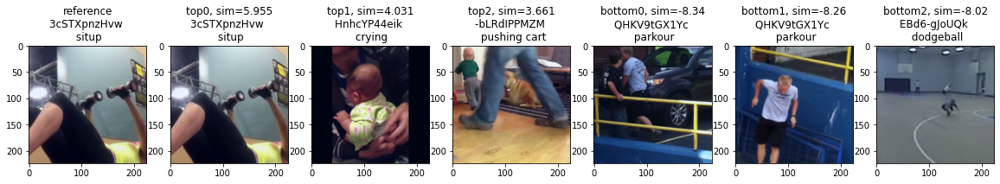

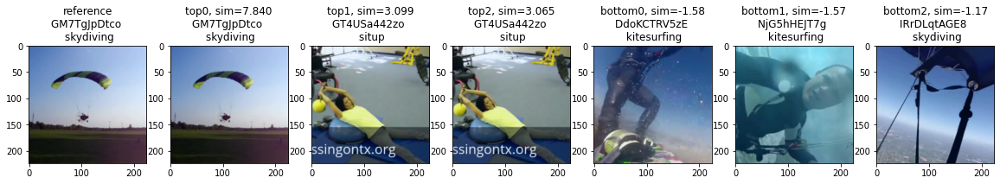

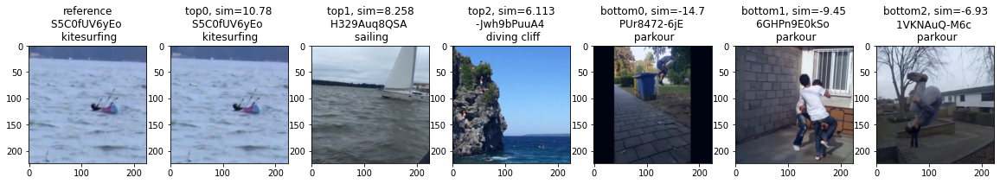

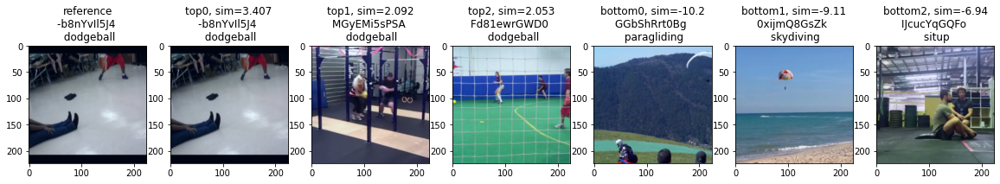

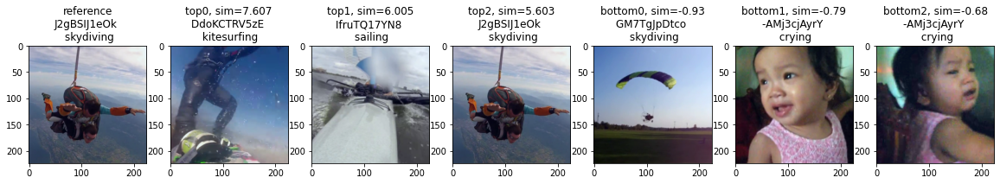

In [8]:
k = 3

for reference in range(100):
    similarities = []
    for neighbor in range(256):
        video_sim = torch.matmul(video_enc[reference, :], video_enc[neighbor, :])
        audio_sim = torch.matmul(audio_enc[reference, :], audio_enc[neighbor, :])
        sim = min(video_sim, audio_sim)
        similarities.append(sim)
    top_k_ind = np.array(similarities).argsort()[-k:][::-1]
    top_k_val = [round(np.array(similarities)[i], 3) for i in top_k_ind]
    bottom_k_ind = np.array(similarities).argsort()[:k]
    bottom_k_val = [round(np.array(similarities)[i], 3) for i in bottom_k_ind]
    
    plt.figure(figsize=(20,40))
    
    plt.subplot(171)
    plot_pics(reference, f"reference\n{sample['label'][reference].split('?')[0]} \n {sample['label'][reference].split('?')[-1]}")
    plt.subplot(172)
    plot_pics(top_k_ind[0], f"top0, " + f"sim={top_k_val[0]}"[:9] + f"\n{sample['label'][top_k_ind[0]].split('?')[0]} \n {sample['label'][top_k_ind[0]].split('?')[-1]}")
    plt.subplot(173)
    plot_pics(top_k_ind[1], f"top1, " + f"sim={top_k_val[1]}"[:9] + f"\n{sample['label'][top_k_ind[1]].split('?')[0]} \n {sample['label'][top_k_ind[1]].split('?')[-1]}")
    plt.subplot(174)
    plot_pics(top_k_ind[2], f"top2, " + f"sim={top_k_val[2]}"[:9] + f"\n{sample['label'][top_k_ind[2]].split('?')[0]} \n {sample['label'][top_k_ind[2]].split('?')[-1]}")
    plt.subplot(175)
    plot_pics(bottom_k_ind[0], f"bottom0, " + f"sim={bottom_k_val[0]}"[:9] + f"\n{sample['label'][bottom_k_ind[0]].split('?')[0]} \n {sample['label'][bottom_k_ind[0]].split('?')[-1]}")
    plt.subplot(176)
    plot_pics(bottom_k_ind[1], f"bottom1, " + f"sim={bottom_k_val[1]}"[:9] + f"\n{sample['label'][bottom_k_ind[1]].split('?')[0]} \n {sample['label'][bottom_k_ind[1]].split('?')[-1]}")
    plt.subplot(177)
    plot_pics(bottom_k_ind[2], f"bottom2, " + f"sim={bottom_k_val[2]}"[:9] + f"\n{sample['label'][bottom_k_ind[2]].split('?')[0]} \n {sample['label'][bottom_k_ind[2]].split('?')[-1]}")
    
    plt.show()
